# Simulation using Concord

In [68]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [69]:
import numpy as np
import scanpy as sc
import time
from pathlib import Path
import torch
import Concord as ccd
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [70]:
proj_name = "simulation_ccd_tree_cycle"
save_dir = f"../save/dev_{proj_name}-{time.strftime('%b%d')}/"
save_dir = Path(save_dir)
save_dir.mkdir(parents=True, exist_ok=True)
device = torch.device('cuda:3' if torch.cuda.is_available() else 'cpu')
print(device)
seed = 0
ccd.ul.set_seed(seed)

cpu


Concord.utils.simulation - INFO - Simulating dataset in Gatto et al. 2023 with distribution: normal with background expression 0 and dispersion 5.
(198, 1000)
(40, 1000)
Concord.utils.simulation - INFO - Simulating batch-specific features effect on batch_1 by appending a set of batch-specific genes with normal distributed value with level 20 and dispersion 1.0.
Concord.utils.simulation - INFO - Simulating batch-specific features effect on batch_2 by appending a set of batch-specific genes with normal distributed value with level 20 and dispersion 1.0.


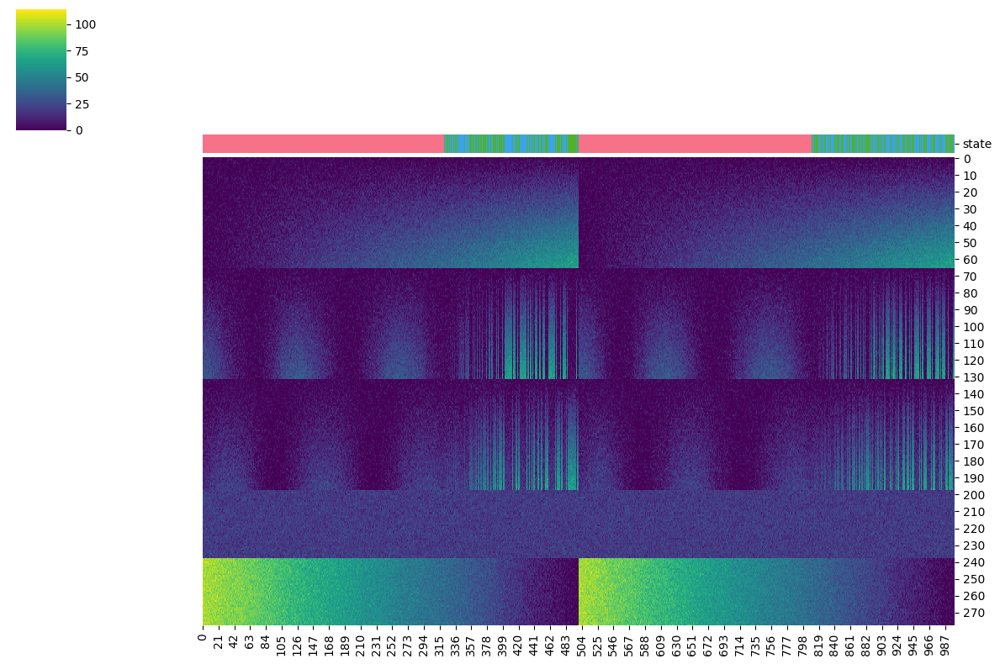

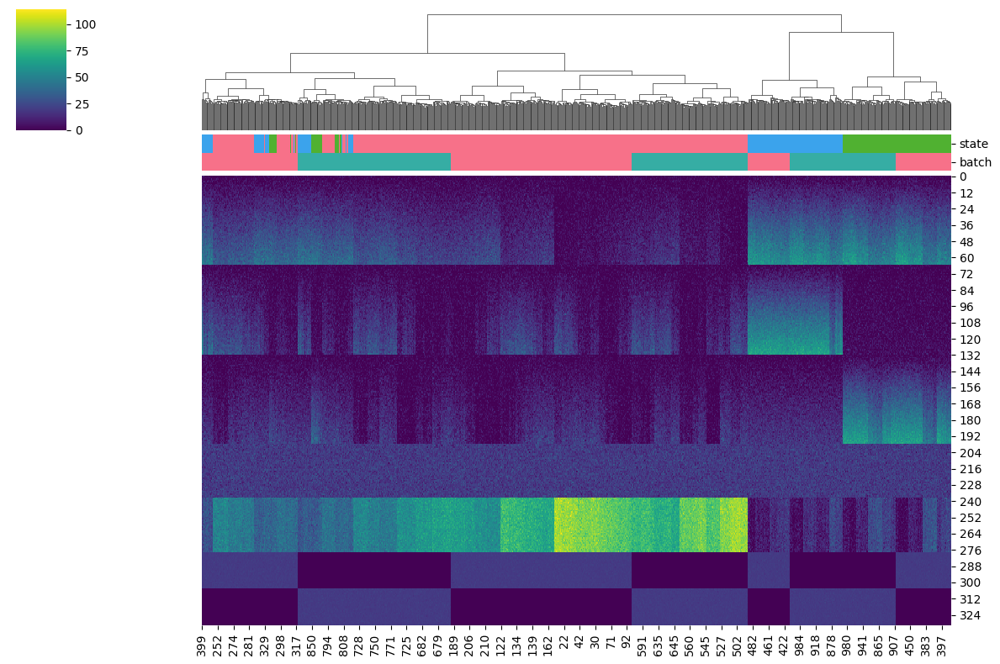

In [148]:
from Concord.utils.simulation import Simulation
#group_key = 'group'
group_key = 'state'
batch_key = 'batch'
state_type = 'gatto'
batch_type = 'batch_specific_features'
distribution = 'normal'
# Create an instance of the Simulation class
file_suffix = f"{state_type}_{batch_type}_{distribution}_{time.strftime('%b%d-%H%M')}"

sim = Simulation(n_cells=1000, n_genes=200, n_batches=2, n_states=3, 
                 state_type=state_type, 
                 state_distribution = distribution, 
                 state_level=0, 
                 state_min_level=0,
                 state_dispersion=5, 
                 program_structure='linear',
                 program_on_time_fraction=0.0,
                 trajectory_program_num=4,
                 trajectory_loop_to=1,
                 tree_branching_factor=2,
                 tree_depth=2,
                 tree_program_decay=0.7,
                 batch_distribution=distribution,
                 batch_type=batch_type, 
                 batch_level=[20,20], 
                 batch_dispersion=[1.0, 1.0], 
                 non_neg=True, to_int=True,
                 seed=42)

# Generate the simulated data
adata, adata_state = sim.simulate_data()
file_suffix = f"{state_type}_{batch_type}_{distribution}_{time.strftime('%b%d-%H%M')}"
ccd.pl.heatmap_with_annotations(adata_state, val='X', obs_keys=[group_key], cluster_cols=False, cluster_rows=False, value_annot=False, cmap='viridis', save_path=save_dir/f'state_heatmap_{file_suffix}.png') 
ccd.pl.heatmap_with_annotations(adata, val='X', obs_keys=[group_key, batch_key], cluster_cols=True, cluster_rows=False, value_annot=False, cmap='viridis', save_path=save_dir/f'heatmap_{file_suffix}.png') 

### NO batch effect, PCA and UMAP

In [149]:
n_pcs = min(adata_state.n_obs, adata_state.n_vars)-1
sc.pp.pca(adata_state, n_comps=n_pcs)
sc.pp.neighbors(adata_state, n_neighbors=30, n_pcs=n_pcs)
sc.tl.umap(adata_state, min_dist=0.5)

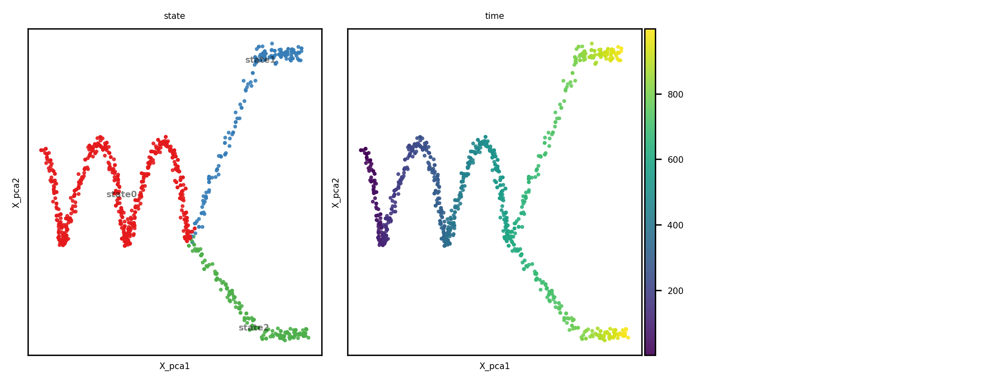

In [150]:
show_basis = 'X_pca'
show_cols = ['state', 'time']

ccd.pl.plot_embedding(
    adata_state, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"nobatch_{show_basis}_{file_suffix}.png"
)

In [121]:
show_basis = 'X_pca'
ccd.pl.plot_embedding_3d(
    adata_state, basis=show_basis, color_by=show_cols,
    save_path= save_dir / f"{show_basis}_{file_suffix}.html",
    point_size=3, opacity=0.8, width=1000, height=800
)

Concord - INFO - 3D plot saved to ../save/dev_simulation_ccd_tree_cycle-Oct31/X_pca_gatto_batch_specific_features_normal_Oct31-2010_state.html


Concord - INFO - 3D plot saved to ../save/dev_simulation_ccd_tree_cycle-Oct31/X_pca_gatto_batch_specific_features_normal_Oct31-2010_time.html


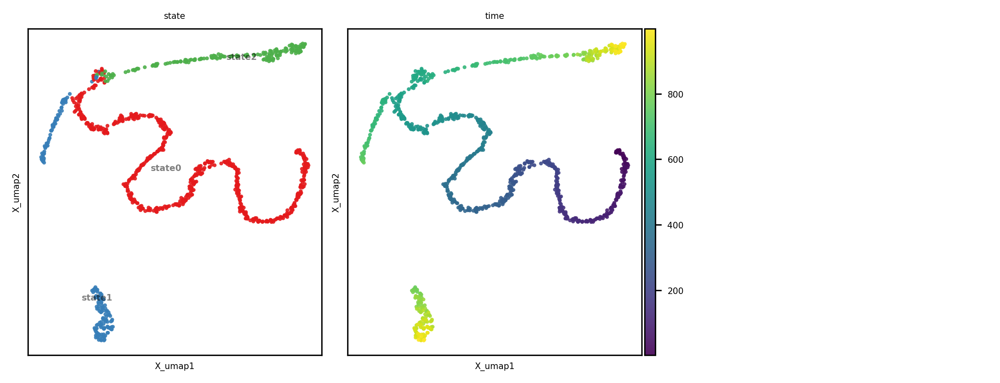

In [303]:
show_basis = 'X_umap'

ccd.pl.plot_embedding(
    adata_state, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"nobatch_{show_basis}_{file_suffix}.png"
)

### No batch correction, PCA and UMAP

In [8]:
n_pcs = min(adata.n_obs, adata.n_vars)-1
sc.pp.pca(adata, n_comps=n_pcs)
sc.pp.neighbors(adata, n_neighbors=30, n_pcs=n_pcs)
sc.tl.umap(adata, min_dist=0.5)
adata.obsm["Unintegrated"] = adata.obsm["X_pca"]

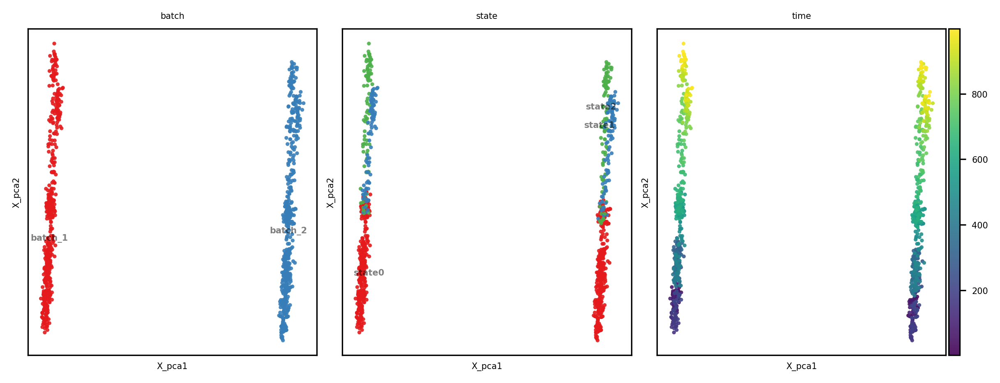

In [253]:
show_basis = 'X_pca'
show_cols = [batch_key, 'state', 'time']

ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"wtbatch_{show_basis}_{file_suffix}.png"
)

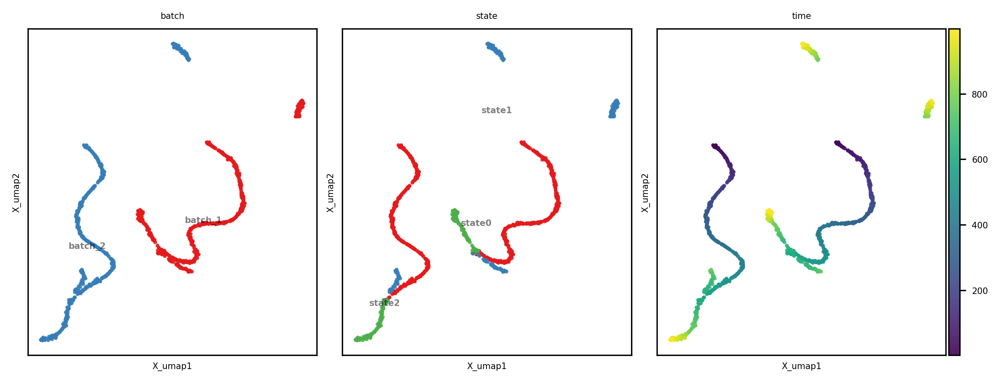

In [254]:
show_basis = 'X_umap'
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"wtbatch_{show_basis}_{file_suffix}.png"
)

In [255]:
# PCA and 3D visualization
pca = PCA(n_components=3)
adata.obsm['X_pca'] = pca.fit_transform(adata.X)
show_cols=['time','state']
show_basis='X_pca'
# 3D visualization
ccd.pl.plot_embedding_3d(
    adata, basis=show_basis, color_by=show_cols,
    save_path= save_dir / f"{show_basis}_{file_suffix}.html",
    point_size=3, opacity=0.8, width=1000, height=800
)

Concord - INFO - 3D plot saved to ../save/dev_simulation_ccd_tree_cycle-Oct30/X_pca_gatto_batch_specific_features_normal_Oct31-1145_time.html


Concord - INFO - 3D plot saved to ../save/dev_simulation_ccd_tree_cycle-Oct30/X_pca_gatto_batch_specific_features_normal_Oct31-1145_state.html


## Concord on adata_state with no batch added 

In [151]:
cur_ccd = ccd.Concord(adata=adata_state, 
                      input_feature=None, 
                      batch_size=64,
                      n_epochs=10,
                      lr=1e-2,
                      train_frac=1.0,
                      schedule_ratio = 0.97,
                      latent_dim=16, # latent dimension
                      encoder_dims = [64], # encoder architecture
                      decoder_dims = [64], # decoder architecture
                      norm_type = 'layer_norm',
                      use_importance_mask=False,
                      #importance_penalty_weight=1.0,
                      use_decoder=False,
                      domain_embedding_dim=8,
                      domain_key=None, # key indicating batch
                      augmentation_mask_prob = 0.5, # augmentation mask probability, recommend between 0.1 and 0.7
                      clr_temperature = 0.5, # temperature for NT-Xent loss
                      seed=seed, # random seed
                      p_intra_domain = 1.0, # probability of intra-domain sampling
                      p_intra_knn=0.0,
                      sampler_knn = 128,
                      verbose=True, # print training progress
                      inplace=True, # whether to modify original adata, set to False if you want to keep all expressions
                      device=device, # device to run on
                      save_dir=save_dir # directory to save model checkpoints
                      ) 

# Encode data, saving the latent embedding in adata.obsm['Concord']
output_key = 'Concord'
file_suffix = f"{time.strftime('%b%d-%H%M')}"
cur_ccd.encode_adata(input_layer_key='X', output_key=output_key, preprocess=False)
# Save the latent embedding to a file, so that it can be loaded later
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, save_dir / f"obsm_{file_suffix}.h5")

Concord - WARNING - No input feature list provided. It is recommended to first select features using the command `concord.ul.select_features()`.
Concord - INFO - Proceeding with all 278 features in the dataset.
Concord - WARNING - domain/batch information not found, all samples will be treated as from single domain/batch.
Concord - INFO - Encoder input dim: 278
Concord - INFO - Model loaded to device: cpu
Concord - INFO - Total number of parameters: 19064
Concord.model.anndataset - INFO - Initialized dataset with 1000 samples. Data structure: ['input', 'domain', 'idx']
Concord.model.dataloader - INFO - Using existing embedding 'X_pca' from adata.obsm
Concord.model.knn - WARNING - FAISS not found. Using sklearn for k-NN computation.
Concord.model.dataloader - INFO - Number of unique_domains: 1
Concord.model.dataloader - INFO - Final p_intra_domain values: single_domain: 1.00
p_intra_knn: 0.0
Concord - INFO - Starting epoch 1/10
Concord - INFO - Processing chunk 1/1 for epoch 1
Concord -

Epoch 0 Training: 15it [00:00, 117.88it/s, loss=4.31]

Concord - INFO - Epoch   0 | Train Loss: 4.43, MSE: 0.00, CLASS: 0.00, CONTRAST: 4.43, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 2/10
Concord - INFO - Processing chunk 1/1 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 1000



Epoch 1 Training: 100%|██████████| 15/15 [00:00<00:00, 100.16it/s, loss=4.14]

Concord - INFO - Epoch   1 | Train Loss: 4.20, MSE: 0.00, CLASS: 0.00, CONTRAST: 4.20, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 3/10
Concord - INFO - Processing chunk 1/1 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 1000


Epoch 2 Training: 100%|██████████| 15/15 [00:00<00:00, 132.66it/s, loss=4.05]

Concord - INFO - Epoch   2 | Train Loss: 4.06, MSE: 0.00, CLASS: 0.00, CONTRAST: 4.06, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 4/10
Concord - INFO - Processing chunk 1/1 for epoch 4
Concord - INFO - Number of samples in train_dataloader: 1000



Epoch 3 Training: 100%|██████████| 15/15 [00:00<00:00, 90.11it/s, loss=3.83]


Concord - INFO - Epoch   3 | Train Loss: 3.93, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.93, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 5/10
Concord - INFO - Processing chunk 1/1 for epoch 5
Concord - INFO - Number of samples in train_dataloader: 1000


Epoch 4 Training: 100%|██████████| 15/15 [00:00<00:00, 126.37it/s, loss=3.82]

Concord - INFO - Epoch   4 | Train Loss: 3.82, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.82, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 6/10


Concord - INFO - Processing chunk 1/1 for epoch 6
Concord - INFO - Number of samples in train_dataloader: 1000


Epoch 5 Training: 100%|██████████| 15/15 [00:00<00:00, 77.08it/s, loss=3.67]

Concord - INFO - Epoch   5 | Train Loss: 3.75, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.75, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 7/10


Concord - INFO - Processing chunk 1/1 for epoch 7
Concord - INFO - Number of samples in train_dataloader: 1000


Epoch 6 Training: 100%|██████████| 15/15 [00:00<00:00, 68.90it/s, loss=3.7]

Concord - INFO - Epoch   6 | Train Loss: 3.73, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.73, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 8/10


Concord - INFO - Processing chunk 1/1 for epoch 8
Concord - INFO - Number of samples in train_dataloader: 1000


Epoch 7 Training: 100%|██████████| 15/15 [00:00<00:00, 83.04it/s, loss=3.65]

Concord - INFO - Epoch   7 | Train Loss: 3.72, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.72, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 9/10


Concord - INFO - Processing chunk 1/1 for epoch 9
Concord - INFO - Number of samples in train_dataloader: 1000


Epoch 8 Training: 100%|██████████| 15/15 [00:00<00:00, 86.70it/s, loss=3.65]


Concord - INFO - Epoch   8 | Train Loss: 3.68, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.68, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 10/10
Concord - INFO - Processing chunk 1/1 for epoch 10
Concord - INFO - Number of samples in train_dataloader: 1000


Epoch 9 Training: 100%|██████████| 15/15 [00:00<00:00, 127.90it/s, loss=3.71]

Concord - INFO - Epoch   9 | Train Loss: 3.68, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.68, IMPORTANCE: 0.00
Concord - INFO - Model saved to ../save/dev_simulation_ccd_tree_cycle-Oct31/final_model.pth
Concord - INFO - Final model saved at: ../save/dev_simulation_ccd_tree_cycle-Oct31/final_model.pth; Configuration saved at: ../save/dev_simulation_ccd_tree_cycle-Oct31/config.json.
Concord.model.anndataset - INFO - Initialized dataset with 1000 samples. Data structure: ['input', 'domain', 'idx']


Concord - INFO - Predicting for chunk 1/1
Concord - INFO - No domain specified for decoding. Using the same domain as the input data.


In [152]:
adata_state.obsm['Concord']

array([[-0.13761579, -0.14087127,  0.96091986, ..., -0.12383857,
        -0.03370246, -0.04152596],
       [-0.13678925, -0.13528937,  0.720599  , ..., -0.12508206,
        -0.03096159, -0.03566558],
       [-0.1350253 , -0.13516076,  0.74286175, ..., -0.12491041,
        -0.03252527, -0.03611889],
       ...,
       [ 1.4169289 , -0.06448863, -0.13064699, ...,  0.45418495,
        -0.09143531, -0.04101625],
       [ 0.68363893,  0.4735011 , -0.17770396, ..., -0.08107471,
        -0.09149247,  0.04520643],
       [ 0.67636037,  0.47365773, -0.17622925, ..., -0.08187624,
        -0.09156232,  0.03875166]], dtype=float32)

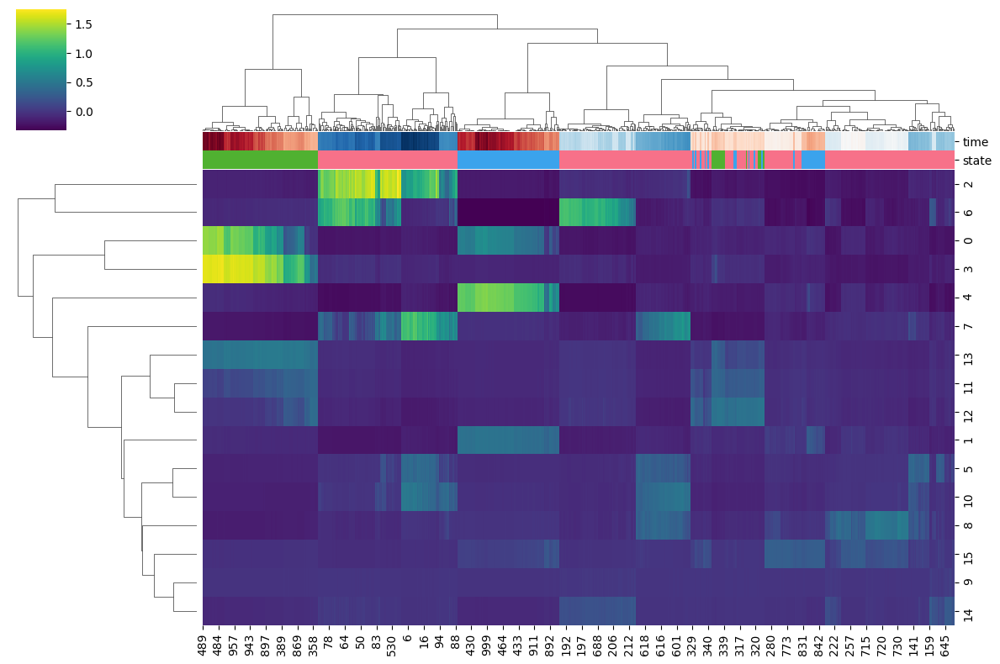

In [153]:
ccd.pl.heatmap_with_annotations(adata_state, val='Concord', obs_keys=['time','state'], cluster_cols=True, cluster_rows=True, cmap='viridis', save_path=save_dir/f'Concord_latent_heatmap_{file_suffix}.png')

Concord - INFO - PCA performed on source data with 15 components
Concord - INFO - PCA embedding stored in adata.obsm['Concord_PCA']


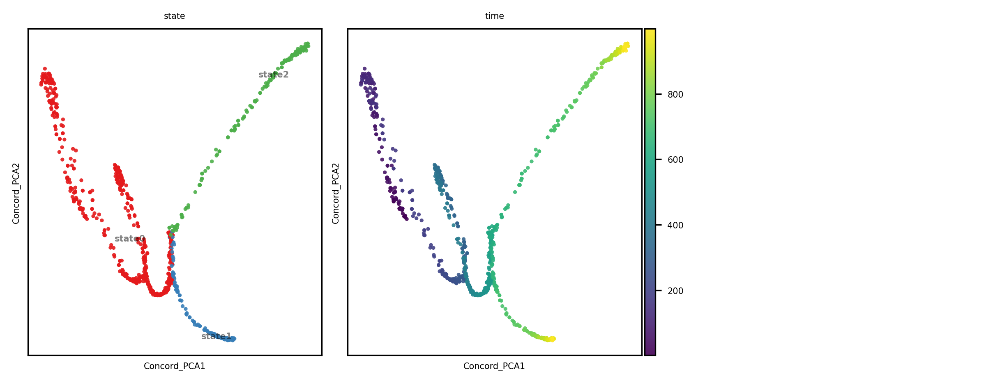

In [154]:
output_key = 'Concord'
n_pc = min(adata_state.obsm[output_key].shape[1], adata.shape[0]) - 1
ccd.ul.run_pca(adata_state, source_key=output_key, result_key=f'{output_key}_PCA', n_pc=n_pc, random_state=seed)
show_basis = f'{output_key}_PCA'
show_cols=['state','time']  
ccd.pl.plot_embedding(
    adata_state, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

In [155]:
ccd.pl.plot_embedding_3d(
    adata_state, basis='Concord_PCA', color_by=show_cols,
    save_path= save_dir / f"{show_basis}_{file_suffix}.html",
    point_size=3, opacity=0.8, width=1000, height=800
)

Concord - INFO - 3D plot saved to ../save/dev_simulation_ccd_tree_cycle-Oct31/Concord_PCA_Oct31-2053_state.html


Concord - INFO - 3D plot saved to ../save/dev_simulation_ccd_tree_cycle-Oct31/Concord_PCA_Oct31-2053_time.html


Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']


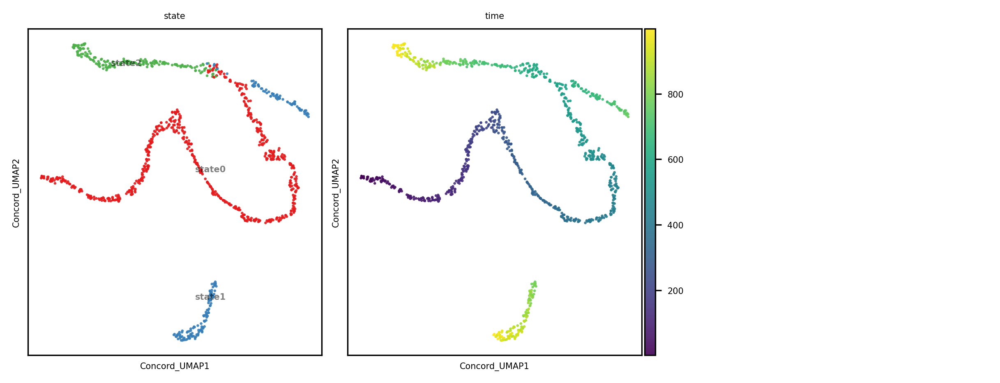

In [33]:
ccd.ul.run_umap(adata_state, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_neighbors=30, min_dist=0.5, metric='euclidean', random_state=seed)
output_key = 'Concord'
show_basis = f'{output_key}_UMAP'
ccd.pl.plot_embedding(
    adata_state, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=10, legend_loc='on data',
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

In [34]:
ccd.ul.run_umap(adata_state, source_key='Concord', umap_key='Concord_UMAP_3D', n_components=3, n_neighbors=30, min_dist=0.5, metric='euclidean', random_state=seed)
ccd.pl.plot_embedding_3d(
    adata_state, basis='Concord_UMAP_3D', color_by=show_cols,
    save_path= save_dir / f"{show_basis}_{file_suffix}.html",
    point_size=3, opacity=0.8, width=1000, height=800
)

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP_3D']
Concord - INFO - 3D plot saved to ../save/dev_simulation_ccd_tree_cycle-Oct31/Concord_UMAP_Oct31-1354_state.html


Concord - INFO - 3D plot saved to ../save/dev_simulation_ccd_tree_cycle-Oct31/Concord_UMAP_Oct31-1354_time.html


## Concord on batch adata

In [279]:
cur_ccd = ccd.Concord(adata=adata, 
                      input_feature=None, 
                      batch_size=32,
                      n_epochs=10,
                      lr=1e-2,
                      train_frac=1.0,
                      schedule_ratio = 0.97,
                      latent_dim=16, # latent dimension
                      encoder_dims = [64], # encoder architecture
                      decoder_dims = [64], # decoder architecture
                      norm_type = 'batch_norm',
                      use_importance_mask=False,
                      #importance_penalty_weight=1.0,
                      use_decoder=False,
                      domain_embedding_dim=8,
                      domain_key='batch', # key indicating batch
                      augmentation_mask_prob = 0.5, # augmentation mask probability, recommend between 0.1 and 0.7
                      clr_temperature = 0.5, # temperature for NT-Xent loss
                      seed=seed, # random seed
                      p_intra_domain = 1.0, # probability of intra-domain sampling
                      p_intra_knn=0.0,
                      sampler_knn = 128,
                      verbose=True, # print training progress
                      inplace=True, # whether to modify original adata, set to False if you want to keep all expressions
                      device=device, # device to run on
                      save_dir=save_dir # directory to save model checkpoints
                      ) 

# Encode data, saving the latent embedding in adata.obsm['Concord']
output_key = 'Concord'
file_suffix = f"{time.strftime('%b%d-%H%M')}"
cur_ccd.encode_adata(input_layer_key='X', output_key=output_key, preprocess=False)
# Save the latent embedding to a file, so that it can be loaded later
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, save_dir / f"obsm_{file_suffix}.h5")

Concord - WARNING - No input feature list provided. It is recommended to first select features using the command `concord.ul.select_features()`.
Concord - INFO - Proceeding with all 108 features in the dataset.
Concord - INFO - Column 'batch' is already of type: category
Concord - INFO - Unused levels dropped for column 'batch'.
Concord - INFO - Encoder input dim: 108
Concord - INFO - Model loaded to device: cpu
Concord - INFO - Total number of parameters: 8192
Concord.model.anndataset - INFO - Initialized dataset with 1000 samples. Data structure: ['input', 'domain', 'idx']
Concord.model.dataloader - INFO - Using existing embedding 'X_pca' from adata.obsm
Concord.model.knn - WARNING - FAISS not found. Using sklearn for k-NN computation.
Concord.model.dataloader - INFO - Number of unique_domains: 2
Concord.model.dataloader - INFO - Final p_intra_domain values: batch_1: 1.00, batch_2: 1.00
p_intra_knn: 0.0
Concord - INFO - Starting epoch 1/10
Concord - INFO - Processing chunk 1/1 for ep

Epoch 0 Training: 30it [00:00, 142.16it/s, loss=4.32]

Concord - INFO - Epoch   0 | Train Loss: 4.22, MSE: 0.00, CLASS: 0.00, CONTRAST: 4.22, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 2/10
Concord - INFO - Processing chunk 1/1 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 1000


Epoch 1 Training: 100%|██████████| 30/30 [00:00<00:00, 155.59it/s, loss=4.33]

Concord - INFO - Epoch   1 | Train Loss: 4.21, MSE: 0.00, CLASS: 0.00, CONTRAST: 4.21, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 3/10
Concord - INFO - Processing chunk 1/1 for epoch 3


Concord - INFO - Number of samples in train_dataloader: 1000


Epoch 2 Training: 100%|██████████| 30/30 [00:00<00:00, 81.09it/s, loss=4.34]

Concord - INFO - Epoch   2 | Train Loss: 4.20, MSE: 0.00, CLASS: 0.00, CONTRAST: 4.20, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 4/10
Concord - INFO - Processing chunk 1/1 for epoch 4
Concord - INFO - Number of samples in train_dataloader: 1000



Epoch 3 Training: 100%|██████████| 30/30 [00:00<00:00, 149.72it/s, loss=4.24]

Concord - INFO - Epoch   3 | Train Loss: 4.20, MSE: 0.00, CLASS: 0.00, CONTRAST: 4.20, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 5/10
Concord - INFO - Processing chunk 1/1 for epoch 5


Concord - INFO - Number of samples in train_dataloader: 1000


Epoch 4 Training: 100%|██████████| 30/30 [00:00<00:00, 89.96it/s, loss=4.16] 

Concord - INFO - Epoch   4 | Train Loss: 4.17, MSE: 0.00, CLASS: 0.00, CONTRAST: 4.17, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 6/10
Concord - INFO - Processing chunk 1/1 for epoch 6
Concord - INFO - Number of samples in train_dataloader: 1000



Epoch 5 Training: 100%|██████████| 30/30 [00:00<00:00, 137.85it/s, loss=4.21]

Concord - INFO - Epoch   5 | Train Loss: 4.18, MSE: 0.00, CLASS: 0.00, CONTRAST: 4.18, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 7/10


Concord - INFO - Processing chunk 1/1 for epoch 7
Concord - INFO - Number of samples in train_dataloader: 1000


Epoch 6 Training: 100%|██████████| 30/30 [00:00<00:00, 144.52it/s, loss=4.25]

Concord - INFO - Epoch   6 | Train Loss: 4.19, MSE: 0.00, CLASS: 0.00, CONTRAST: 4.19, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 8/10
Concord - INFO - Processing chunk 1/1 for epoch 8
Concord - INFO - Number of samples in train_dataloader: 1000


Epoch 7 Training: 100%|██████████| 30/30 [00:00<00:00, 94.67it/s, loss=4.21]

Concord - INFO - Epoch   7 | Train Loss: 4.16, MSE: 0.00, CLASS: 0.00, CONTRAST: 4.16, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 9/10
Concord - INFO - Processing chunk 1/1 for epoch 9
Concord - INFO - Number of samples in train_dataloader: 1000



Epoch 8 Training: 100%|██████████| 30/30 [00:00<00:00, 142.39it/s, loss=4.06]

Concord - INFO - Epoch   8 | Train Loss: 4.15, MSE: 0.00, CLASS: 0.00, CONTRAST: 4.15, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 10/10


Concord - INFO - Processing chunk 1/1 for epoch 10
Concord - INFO - Number of samples in train_dataloader: 1000


Epoch 9 Training: 100%|██████████| 30/30 [00:00<00:00, 100.96it/s, loss=4.13]

Concord - INFO - Epoch   9 | Train Loss: 4.15, MSE: 0.00, CLASS: 0.00, CONTRAST: 4.15, IMPORTANCE: 0.00
Concord - INFO - Model saved to ../save/dev_simulation_ccd_tree_cycle-Oct30/final_model.pth


Concord - INFO - Final model saved at: ../save/dev_simulation_ccd_tree_cycle-Oct30/final_model.pth; Configuration saved at: ../save/dev_simulation_ccd_tree_cycle-Oct30/config.json.
Concord.model.anndataset - INFO - Initialized dataset with 1000 samples. Data structure: ['input', 'domain', 'idx']
Concord - INFO - Predicting for chunk 1/1
Concord - INFO - No domain specified for decoding. Using the same domain as the input data.


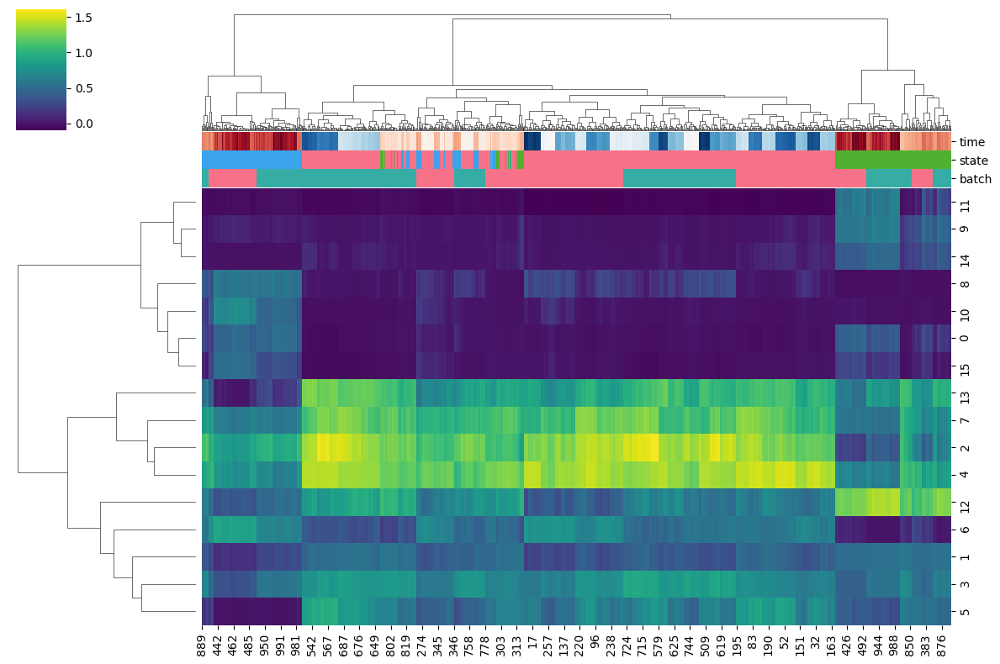

In [280]:
ccd.pl.heatmap_with_annotations(adata, val='Concord', obs_keys=['time','state', 'batch'], cluster_cols=True, cluster_rows=True, cmap='viridis', save_path=save_dir/f'Concord_latent_heatmap_{file_suffix}.png')

Concord - INFO - PCA performed on source data with 15 components
Concord - INFO - PCA embedding stored in adata.obsm['Concord_PCA']


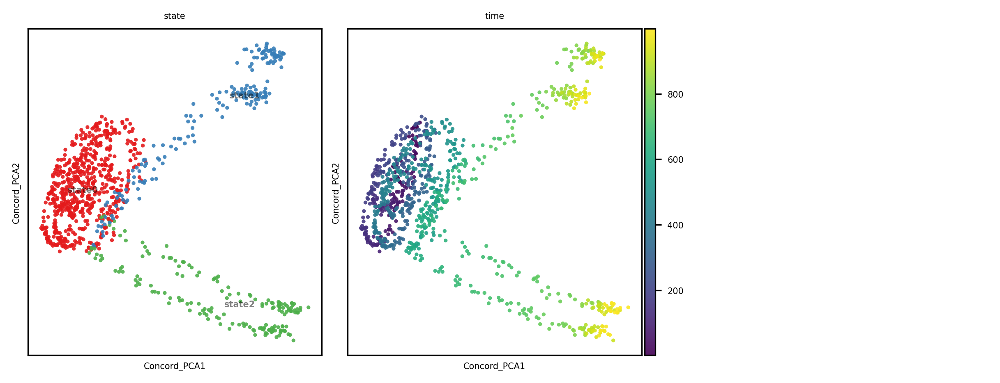

In [281]:
output_key = 'Concord'
n_pc = min(adata.obsm[output_key].shape[1], adata.shape[0]) - 1
ccd.ul.run_pca(adata, source_key=output_key, result_key=f'{output_key}_PCA', n_pc=n_pc, random_state=seed)
show_basis = f'{output_key}_PCA'
show_cols=['state','time']  
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

In [282]:
ccd.pl.plot_embedding_3d(
    adata, basis='Concord_PCA', color_by=show_cols,
    save_path= save_dir / f"{show_basis}_{file_suffix}.html",
    point_size=3, opacity=0.8, width=1000, height=800
)

Concord - INFO - 3D plot saved to ../save/dev_simulation_ccd_tree_cycle-Oct30/Concord_PCA_Oct31-1153_state.html


Concord - INFO - 3D plot saved to ../save/dev_simulation_ccd_tree_cycle-Oct30/Concord_PCA_Oct31-1153_time.html


## loop in cosine space

<Axes: >

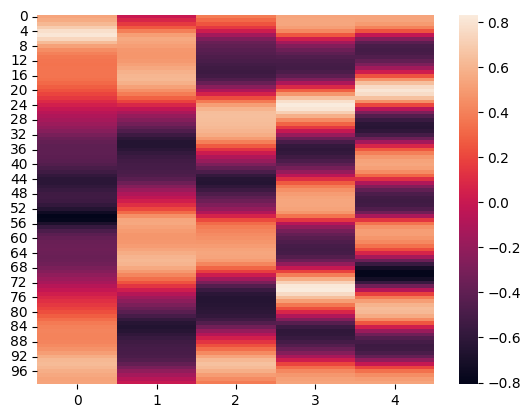

In [161]:
import seaborn as sns
sns.heatmap(X)

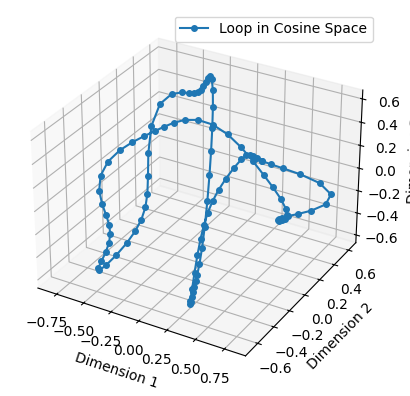

In [66]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Set parameters
num_points = 100     # Number of points in the loop
num_dimensions = 5   # Number of dimensions for the data
t = np.linspace(0, 2 * np.pi, num_points)  # Parameter t from 0 to 2pi

# Define each dimension as a periodic function of t
# Using different sine and cosine frequencies or phases for variety
X = np.zeros((num_points, num_dimensions))
X[:, 0] = np.cos(t)                     # Dimension 1
X[:, 1] = np.sin(2 * t)                 # Dimension 2
X[:, 2] = np.cos(3 * t + np.pi / 4)     # Dimension 3
X[:, 3] = np.sin(4 * t + np.pi / 2)     # Dimension 4
X[:, 4] = np.cos(5 * t)                 # Dimension 5

# Normalize each point to lie on the surface of a hypersphere
X /= np.linalg.norm(X, axis=1, keepdims=True)

# Optional: Visualize in 3D by plotting the first three dimensions
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot(X[:, 0], X[:, 1], X[:, 2], 'o-', markersize=4, label='Loop in Cosine Space')
ax.set_xlabel('Dimension 1')
ax.set_ylabel('Dimension 2')
ax.set_zlabel('Dimension 3')
plt.legend()
plt.show()


In [67]:
# Plot in 3d plotly
import plotly.graph_objects as go

fig = go.Figure(data=[go.Scatter3d(x=X[:, 0], y=X[:, 1], z=X[:, 2], mode='markers')])
fig.show()


### NO batch effect, PCA and UMAP

In [13]:
n_pcs = min(adata_state.n_obs, adata_state.n_vars)-1
sc.pp.pca(adata_state, n_comps=n_pcs)
sc.pp.neighbors(adata_state, n_neighbors=30, n_pcs=n_pcs)
sc.tl.umap(adata_state, min_dist=0.5)

### No batch correction, PCA and UMAP

In [16]:
n_pcs = min(adata.n_obs, adata.n_vars)-1
sc.pp.pca(adata, n_comps=n_pcs)
sc.pp.neighbors(adata, n_neighbors=30, n_pcs=n_pcs)
sc.tl.umap(adata, min_dist=0.5)
adata.obsm["Unintegrated"] = adata.obsm["X_pca"]

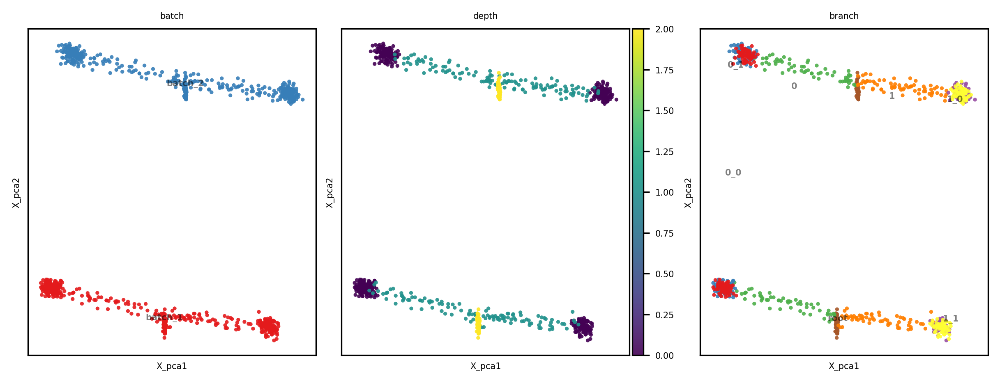

In [17]:
show_basis = 'X_pca'
show_cols = [batch_key, group_key, 'branch']

ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"wtbatch_{show_basis}_{file_suffix}.png"
)

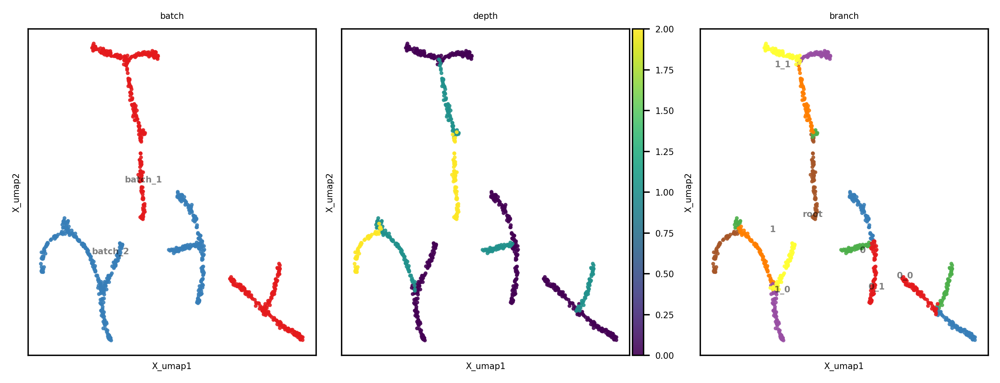

In [18]:
show_basis = 'X_umap'
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"wtbatch_{show_basis}_{file_suffix}.png"
)

### Concord

In [19]:
cur_ccd = ccd.Concord(adata=adata, 
                      input_feature=None, 
                      batch_size=32,
                      n_epochs=15,
                      lr=1e-2,
                      train_frac=1.0,
                      schedule_ratio = 0.97,
                      latent_dim=32, # latent dimension
                      encoder_dims = [64], # encoder architecture
                      decoder_dims = [64], # decoder architecture
                      norm_type = 'layer_norm',
                      use_importance_mask=False,
                      #importance_penalty_weight=1.0,
                      use_decoder=False,
                      domain_embedding_dim=8,
                      domain_key=batch_key, # key indicating batch
                      augmentation_mask_prob = 0.5, # augmentation mask probability, recommend between 0.1 and 0.7
                      clr_temperature = 0.5, # temperature for NT-Xent loss
                      seed=seed, # random seed
                      p_intra_domain = 1.0, # probability of intra-domain sampling
                      p_intra_knn=0.3,
                      sampler_knn = 128,
                      verbose=True, # print training progress
                      inplace=True, # whether to modify original adata, set to False if you want to keep all expressions
                      device=device, # device to run on
                      save_dir=save_dir # directory to save model checkpoints
                      ) 

# Encode data, saving the latent embedding in adata.obsm['Concord']
output_key = 'Concord'
cur_ccd.encode_adata(input_layer_key='X', output_key=output_key, preprocess=False)
# Save the latent embedding to a file, so that it can be loaded later
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, save_dir / f"obsm_{file_suffix}.h5")

Concord - WARNING - No input feature list provided. It is recommended to first select features using the command `concord.ul.select_features()`.
Concord - INFO - Proceeding with all 110 features in the dataset.
Concord - INFO - Column 'batch' is already of type: category
Concord - INFO - Unused levels dropped for column 'batch'.
Concord - INFO - Encoder input dim: 110
Concord - INFO - Model loaded to device: cpu
Concord - INFO - Total number of parameters: 9392
Concord.model.anndataset - INFO - Initialized dataset with 874 samples. Data structure: ['input', 'domain', 'idx']
Concord.model.dataloader - INFO - Using existing embedding 'X_pca' from adata.obsm
Concord.model.knn - WARNING - FAISS not found. Using sklearn for k-NN computation.
Concord.model.dataloader - INFO - Number of unique_domains: 2
Concord.model.dataloader - INFO - Final p_intra_domain values: batch_1: 1.00, batch_2: 1.00
p_intra_knn: 0.3
Concord - INFO - Starting epoch 1/15
Concord - INFO - Processing chunk 1/1 for epo

Epoch 0 Training: 26it [00:00, 98.23it/s, loss=3.52]

Concord - INFO - Epoch   0 | Train Loss: 3.69, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.69, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 2/15
Concord - INFO - Processing chunk 1/1 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 874



Epoch 1 Training: 100%|██████████| 26/26 [00:00<00:00, 154.01it/s, loss=3.33]

Concord - INFO - Epoch   1 | Train Loss: 3.44, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.44, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 3/15
Concord - INFO - Processing chunk 1/1 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 874



Epoch 2 Training: 100%|██████████| 26/26 [00:00<00:00, 111.51it/s, loss=3.27]

Concord - INFO - Epoch   2 | Train Loss: 3.36, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.36, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 4/15
Concord - INFO - Processing chunk 1/1 for epoch 4
Concord - INFO - Number of samples in train_dataloader: 874


Epoch 3 Training: 100%|██████████| 26/26 [00:00<00:00, 159.42it/s, loss=3.23]

Concord - INFO - Epoch   3 | Train Loss: 3.25, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.25, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 5/15


Concord - INFO - Processing chunk 1/1 for epoch 5
Concord - INFO - Number of samples in train_dataloader: 874


Epoch 4 Training: 100%|██████████| 26/26 [00:00<00:00, 104.18it/s, loss=3.15]

Concord - INFO - Epoch   4 | Train Loss: 3.15, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.15, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 6/15
Concord - INFO - Processing chunk 1/1 for epoch 6
Concord - INFO - Number of samples in train_dataloader: 874



Epoch 5 Training: 100%|██████████| 26/26 [00:00<00:00, 141.22it/s, loss=3.19]

Concord - INFO - Epoch   5 | Train Loss: 3.13, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.13, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 7/15
Concord - INFO - Processing chunk 1/1 for epoch 7


Concord - INFO - Number of samples in train_dataloader: 874


Epoch 6 Training: 100%|██████████| 26/26 [00:00<00:00, 106.72it/s, loss=3.11]

Concord - INFO - Epoch   6 | Train Loss: 3.10, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.10, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 8/15
Concord - INFO - Processing chunk 1/1 for epoch 8
Concord - INFO - Number of samples in train_dataloader: 874



Epoch 7 Training: 100%|██████████| 26/26 [00:00<00:00, 157.57it/s, loss=2.95]

Concord - INFO - Epoch   7 | Train Loss: 3.06, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.06, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 9/15
Concord - INFO - Processing chunk 1/1 for epoch 9
Concord - INFO - Number of samples in train_dataloader: 874



Epoch 8 Training: 100%|██████████| 26/26 [00:00<00:00, 104.73it/s, loss=3.05]

Concord - INFO - Epoch   8 | Train Loss: 3.00, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.00, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 10/15
Concord - INFO - Processing chunk 1/1 for epoch 10
Concord - INFO - Number of samples in train_dataloader: 874



Epoch 9 Training: 100%|██████████| 26/26 [00:00<00:00, 146.10it/s, loss=2.93]

Concord - INFO - Epoch   9 | Train Loss: 3.01, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.01, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 11/15
Concord - INFO - Processing chunk 1/1 for epoch 11


Concord - INFO - Number of samples in train_dataloader: 874


Epoch 10 Training: 100%|██████████| 26/26 [00:00<00:00, 113.68it/s, loss=3.01]

Concord - INFO - Epoch  10 | Train Loss: 2.97, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.97, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 12/15
Concord - INFO - Processing chunk 1/1 for epoch 12
Concord - INFO - Number of samples in train_dataloader: 874



Epoch 11 Training: 100%|██████████| 26/26 [00:00<00:00, 153.33it/s, loss=2.88]


Concord - INFO - Epoch  11 | Train Loss: 2.97, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.97, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 13/15
Concord - INFO - Processing chunk 1/1 for epoch 13
Concord - INFO - Number of samples in train_dataloader: 874


Epoch 12 Training: 100%|██████████| 26/26 [00:00<00:00, 166.27it/s, loss=3.06]

Concord - INFO - Epoch  12 | Train Loss: 2.98, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.98, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 14/15
Concord - INFO - Processing chunk 1/1 for epoch 14


Concord - INFO - Number of samples in train_dataloader: 874


Epoch 13 Training: 100%|██████████| 26/26 [00:00<00:00, 111.37it/s, loss=2.89]

Concord - INFO - Epoch  13 | Train Loss: 2.96, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.96, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 15/15
Concord - INFO - Processing chunk 1/1 for epoch 15
Concord - INFO - Number of samples in train_dataloader: 874



Epoch 14 Training: 100%|██████████| 26/26 [00:00<00:00, 123.74it/s, loss=2.91]

Concord - INFO - Epoch  14 | Train Loss: 2.95, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.95, IMPORTANCE: 0.00
Concord - INFO - Model saved to ../save/dev_simulation_ccd_tree-Oct29/final_model.pth
Concord - INFO - Final model saved at: ../save/dev_simulation_ccd_tree-Oct29/final_model.pth; Configuration saved at: ../save/dev_simulation_ccd_tree-Oct29/config.json.


Concord.model.anndataset - INFO - Initialized dataset with 874 samples. Data structure: ['input', 'domain', 'idx']
Concord - INFO - Predicting for chunk 1/1
Concord - INFO - No domain specified for decoding. Using the same domain as the input data.


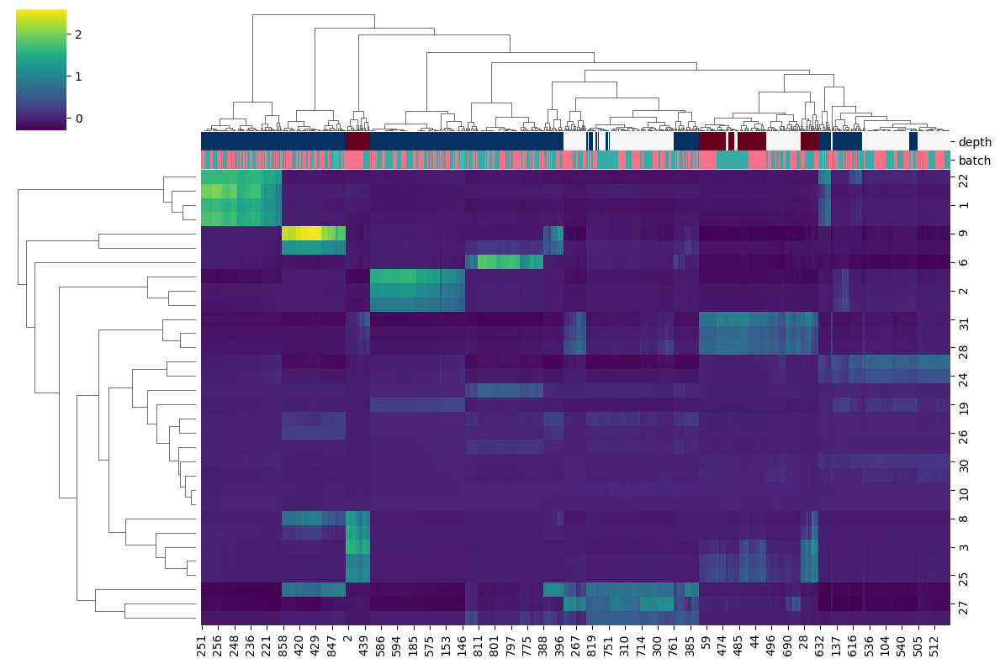

In [20]:
ccd.pl.heatmap_with_annotations(adata, val='Concord', obs_keys=[group_key, batch_key], cluster_cols=True, cluster_rows=True, cmap='viridis', save_path=save_dir/f'Concord_latent_heatmap_{file_suffix}.png')

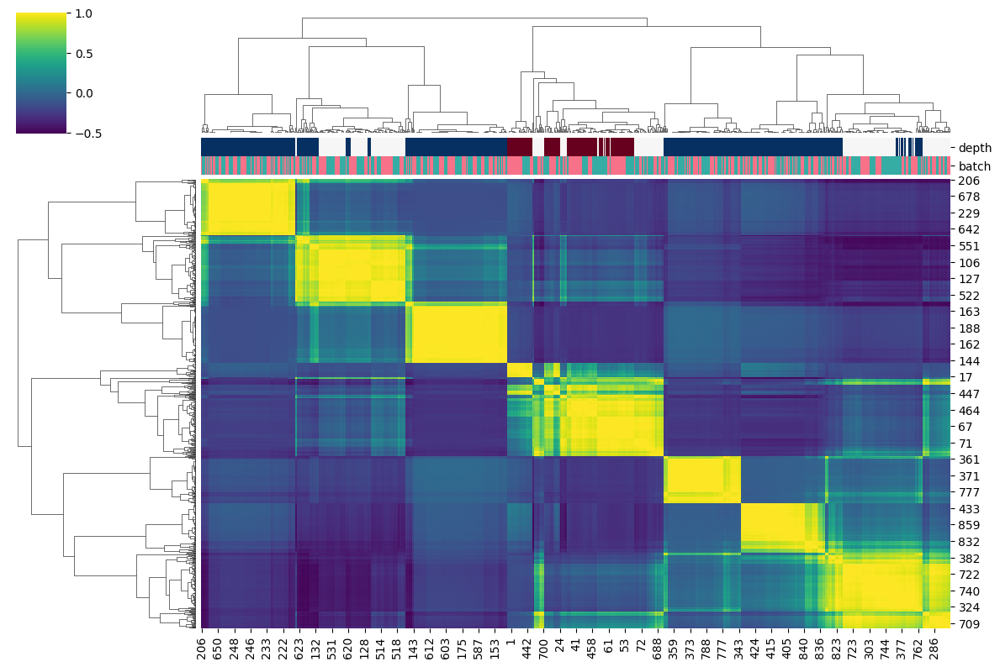

In [21]:
# Compute the correlation matrix
cos_mtx = ccd.ul.cosine_sim(adata.obsm['Concord'])
ccd.pl.heatmap_with_annotations(adata, val=cos_mtx,
                                obs_keys=[group_key, batch_key], cluster_cols=True, cluster_rows=True, cmap='viridis', save_path=save_dir/f'Concord_cosine_{file_suffix}.png')

Concord - INFO - PCA performed on source data with 31 components
Concord - INFO - PCA embedding stored in adata.obsm['Concord_PCA']


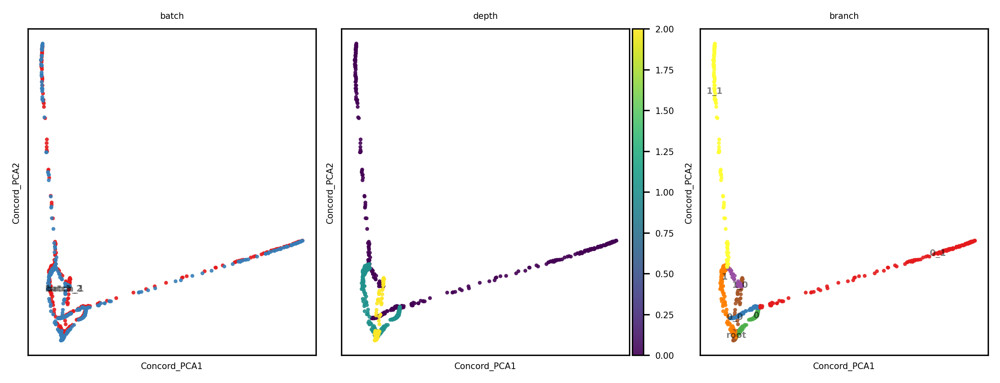

In [22]:
n_pc = min(adata.obsm[output_key].shape[1], adata.shape[0]) - 1
ccd.ul.run_pca(adata, source_key=output_key, result_key=f'{output_key}_PCA', n_pc=n_pc, random_state=seed)
show_basis = f'{output_key}_PCA'
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']


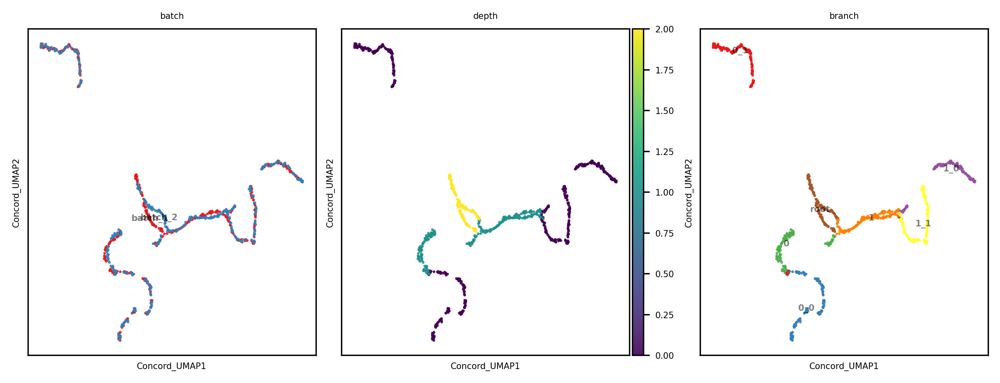

In [77]:
ccd.ul.run_umap(adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_neighbors=30, min_dist=0.5, metric='euclidean', random_state=seed)
output_key = 'Concord'
show_basis = f'{output_key}_UMAP'
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=10, legend_loc='on data',
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

In [78]:
ccd.ul.run_umap(adata, source_key='Concord', umap_key='Concord_UMAP_3D', n_components=3, n_neighbors=30, min_dist=0.5, metric='euclidean', random_state=seed)
ccd.pl.plot_embedding_3d(
    adata, basis='Concord_UMAP_3D', color_by=show_cols,
    save_path= save_dir / f"{show_basis}_{file_suffix}.html",
    point_size=5, opacity=0.8, width=1000, height=800
)

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP_3D']
Concord - INFO - 3D plot saved to ../save/dev_simulation_ccd_tree-Oct29/Concord_UMAP_tree_batch_specific_features_normal_Oct29-1330_batch.html


Concord - INFO - 3D plot saved to ../save/dev_simulation_ccd_tree-Oct29/Concord_UMAP_tree_batch_specific_features_normal_Oct29-1330_depth.html


Concord - INFO - 3D plot saved to ../save/dev_simulation_ccd_tree-Oct29/Concord_UMAP_tree_batch_specific_features_normal_Oct29-1330_branch.html


## Evaluation

### 1. Topological properties

#### 1.0 Persistent homology

In [124]:
adata.obsm

AxisArrays with keys: X_pca, X_umap, Unintegrated, Concord, Concord_PCA, Concord_UMAP, Concord_UMAP_3D

In [125]:
# Compute persistence diagram
#from Concord.utils.persistent_homology import compute_persistent_homology
homology_dimensions = [0,1,2]
dg_state = ccd.ul.compute_persistent_homology(adata_state, key='X_pca', homology_dimensions=homology_dimensions)
dg_pca = ccd.ul.compute_persistent_homology(adata, key='X_pca', homology_dimensions=homology_dimensions)
dg_ccd = ccd.ul.compute_persistent_homology(adata, key='Concord', homology_dimensions=homology_dimensions)

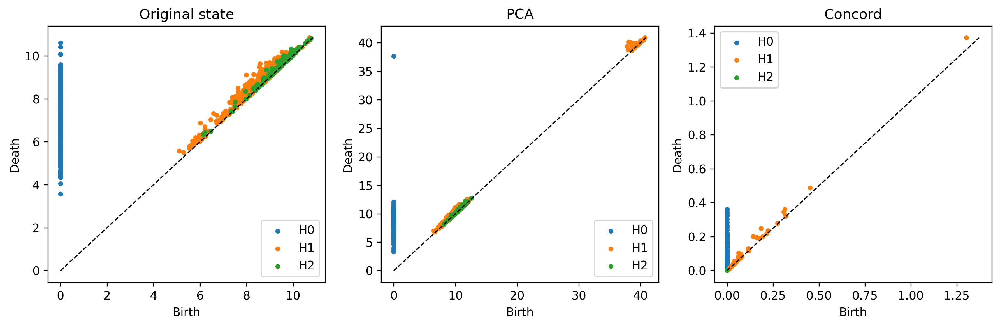

In [126]:
from matplotlib import pyplot as plt
fig, ax = plt.subplots(figsize=(12,4), ncols=3, dpi=300)
ccd.ul.plot_persistence_diagram(dg_state[0], ax=ax[0], marker_size=10, title='Original state', show=False)
ccd.ul.plot_persistence_diagram(dg_pca[0], ax=ax[1], marker_size=10, title='PCA', show=False)
ccd.ul.plot_persistence_diagram(dg_ccd[0], ax=ax[2], marker_size=10, title='Concord', show=False)
plt.tight_layout()
plt.savefig(save_dir / f"persistence_diagrams_{file_suffix}.png")
plt.show()

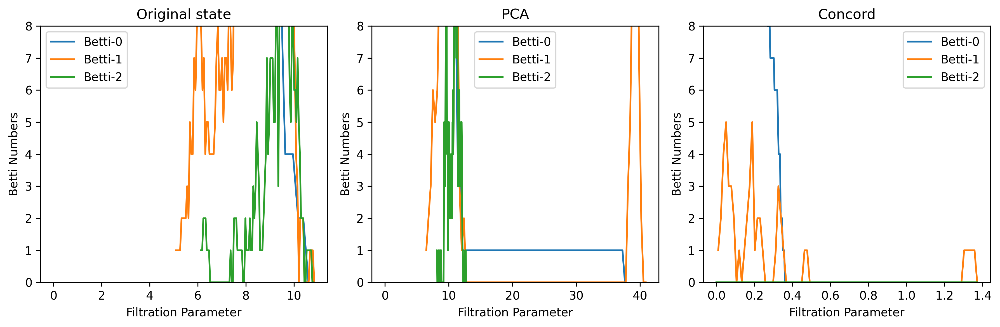

In [127]:
fig, ax = plt.subplots(figsize=(12,4), ncols=3, dpi=300)
ccd.ul.plot_betti_curves(dg_state, nbins=100, ax=ax[0], ymax=8, title='Original state', show=False)
ccd.ul.plot_betti_curves(dg_pca, nbins=100, ax=ax[1], ymax=8, title='PCA', show=False)
ccd.ul.plot_betti_curves(dg_ccd, nbins=100, ax=ax[2], ymax=8, title='Concord', show=False)
plt.tight_layout()
plt.savefig(save_dir / f"betti_curves_{file_suffix}.png")
plt.show()

In [128]:
from gtda.diagrams import PersistenceEntropy

PE = PersistenceEntropy()
pe_state = PE.fit_transform(dg_state)
pe_pca = PE.fit_transform(dg_pca)
pe_ccd = PE.fit_transform(dg_ccd)

print(f"PE state: {pe_state}, PE PCA: {pe_pca}, PE Concord: {pe_ccd}")

PE state: [[9.35808934 8.20590945 6.24696125]], PE PCA: [[9.75137566 8.47008018 6.30605582]], PE Concord: [[ 9.1706167   5.07200664 -1.        ]]


In [129]:
input_dim = 3
layout_dim = 2
color_by = 'depth'
cover_n_intervals = 20
cover_overlap_frac = 0.5
cluster_eps = 0.5
node_scale=30

basis = 'X_pca'
ccd.ul.plot_mapper_graph(adata_state, key=basis, filter_func='projection',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_state_{basis}_{file_suffix}.html")
basis = 'X_pca'
ccd.ul.plot_mapper_graph(adata, key=basis, filter_func='projection',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_{basis}_{file_suffix}.html")
basis = 'Concord'
ccd.ul.plot_mapper_graph(adata, key=basis, filter_func='PCA',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_{basis}_{file_suffix}.html")

In [130]:
adata_state.obs['batch_numeric'] = 0
adata.obs['batch_numeric'] = adata.obs['batch'].astype('category').cat.codes

input_dim = 3
layout_dim = 2
color_by = 'batch_numeric'
cover_n_intervals = 20
cover_overlap_frac = 0.5
cluster_eps = 0.5
node_scale=30
cmap = 'RdBu'

basis = 'X_pca'
ccd.ul.plot_mapper_graph(adata_state, key=basis, filter_func='projection',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by, cmap=cmap,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_state_{basis}_{file_suffix}.html")
basis = 'X_pca'
ccd.ul.plot_mapper_graph(adata, key=basis, filter_func='projection',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by, cmap=cmap,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_{basis}_{file_suffix}.html")
basis = 'Concord'
ccd.ul.plot_mapper_graph(adata, key=basis, filter_func='PCA',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by, cmap=cmap,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_{basis}_{file_suffix}.html")

In [132]:
input_dim = 5
layout_dim = 3
color_by = 'depth'
cover_n_intervals = 30
cover_overlap_frac = 0.5
cluster_eps = 0.5
node_scale=30

basis = 'X_pca'
ccd.ul.plot_mapper_graph(adata_state, key=basis, filter_func='projection',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_state_{basis}_{file_suffix}.html")
basis = 'X_pca'
ccd.ul.plot_mapper_graph(adata, key=basis, filter_func='projection',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_{basis}_{file_suffix}.html")
basis = 'Concord'
ccd.ul.plot_mapper_graph(adata, key=basis, filter_func='PCA',
                            input_dim=input_dim, layout_dim=layout_dim, color_by=color_by,
                            cover_n_intervals=cover_n_intervals, cover_overlap_frac=cover_overlap_frac,
                            cluster_eps=cluster_eps, node_scale=node_scale, save_path=save_dir/f"mapper_{layout_dim}D_{basis}_{file_suffix}.html")

#### 1.3 KNN graph

Concord - INFO - Building 15-NN graph using Concord basis
Concord - INFO - Graph has 874 nodes and 7169 edges


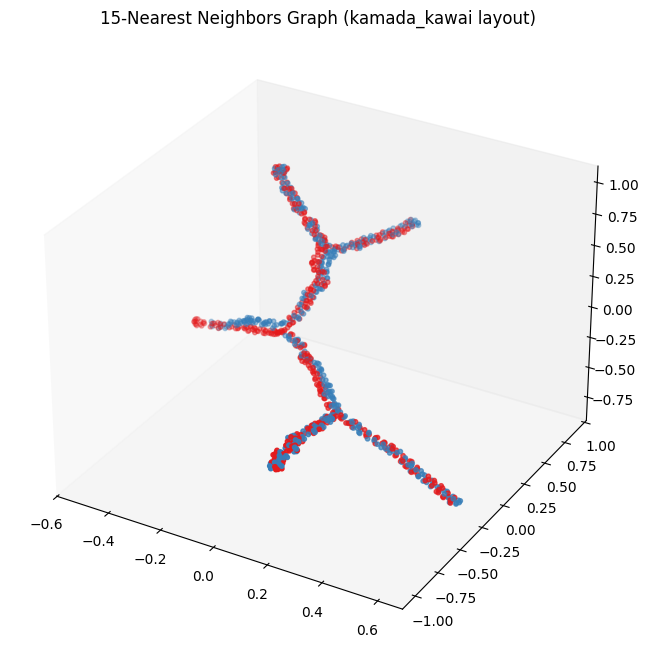

In [102]:
ccd.pl.visualize_knn_graph(
    adata, 
    basis='Concord', 
    color_by='batch', 
    cmap='Set1',
    k=15, 
    dim=3,
    layout='kamada_kawai', 
    draw_edges=False, 
    plotly=False
)

Concord - INFO - Building 30-NN graph using Concord basis
Concord - INFO - Graph has 874 nodes and 15521 edges
Concord - INFO - Computing kamada_kawai layout for visualization
Concord - INFO - Plotting 2D visualization


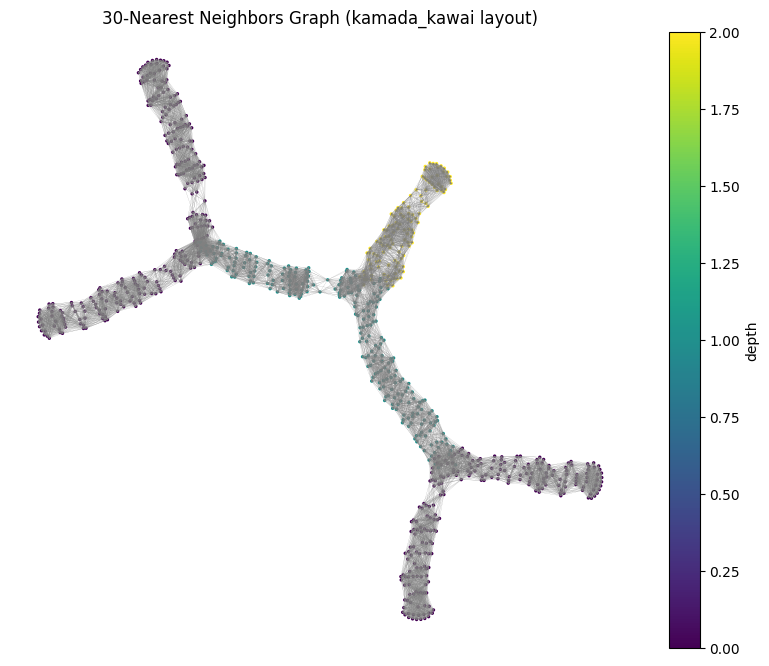

In [109]:
ccd.pl.visualize_knn_graph(
    adata, 
    basis='Concord', 
    color_by='depth', 
    cmap='viridis',
    node_size=2,
    k=30, 
    dim=2,
    layout='kamada_kawai', 
    draw_edges=True, 
    plotly=False
)


Concord - INFO - Building 15-NN graph using Concord basis
Concord - INFO - Graph has 874 nodes and 7169 edges
Concord - INFO - Building 15-NN graph using Concord basis
Concord - INFO - Graph has 874 nodes and 7169 edges
Concord - INFO - Building 15-NN graph using Concord basis
Concord - INFO - Graph has 874 nodes and 7169 edges


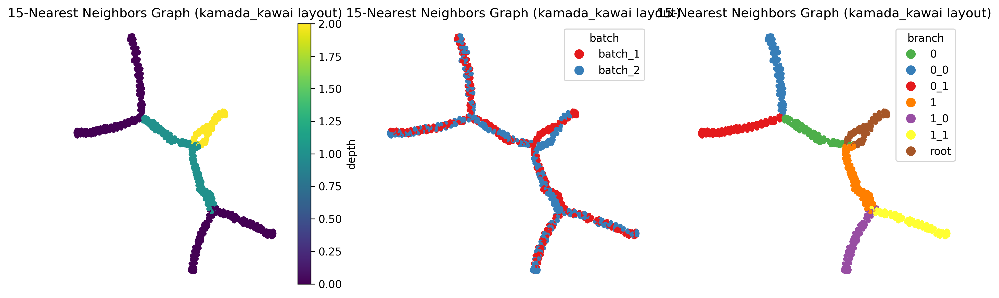

In [103]:
# Knn graph
fig, ax = plt.subplots(figsize=(12,4), ncols=3, dpi=300)

ccd.pl.visualize_knn_graph(
    adata, 
    basis='Concord', 
    color_by='depth', 
    cmap='viridis',
    node_size=2,
    k=15, 
    dim=2,
    layout='kamada_kawai', 
    draw_edges=False, 
    plotly=False,
    ax=ax[0]
)

ccd.pl.visualize_knn_graph(
    adata, 
    basis='Concord', 
    color_by='batch', 
    cmap='Set1',
    node_size=2,
    k=15, 
    dim=2,
    layout='kamada_kawai', 
    draw_edges=False, 
    plotly=False,
    ax=ax[1]
)

ccd.pl.visualize_knn_graph(
    adata, 
    basis='Concord', 
    color_by='branch', 
    cmap='Set1',
    node_size=2,
    k=15, 
    dim=2,
    layout='kamada_kawai', 
    draw_edges=False, 
    plotly=False,
    ax=ax[2]
)

plt.tight_layout()
plt.savefig(save_dir / 'knn_graph.png', dpi=300)
plt.show()

Concord - INFO - Building 15-NN graph using X_pca basis
Concord - INFO - Graph has 874 nodes and 7573 edges
Concord - INFO - Computing kamada_kawai layout for visualization
Concord - INFO - Plotting 2D visualization


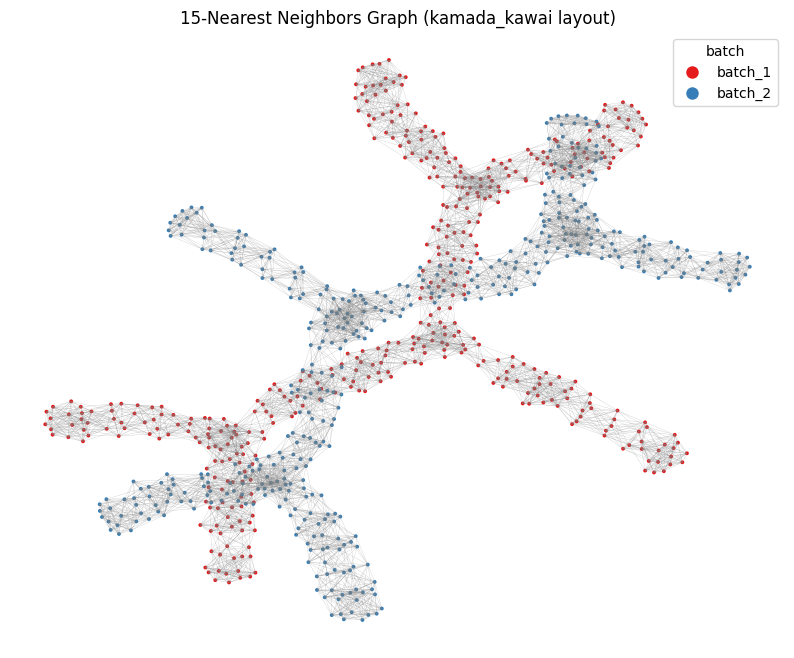

In [114]:
ccd.pl.visualize_knn_graph(
    adata, 
    basis='X_pca', 
    color_by='batch', 
    cmap='Set1',
    node_size=3,
    k=15, 
    dim=2,
    layout='kamada_kawai', 
    draw_edges=True, 
    plotly=False
)


#### KNN and PAGA

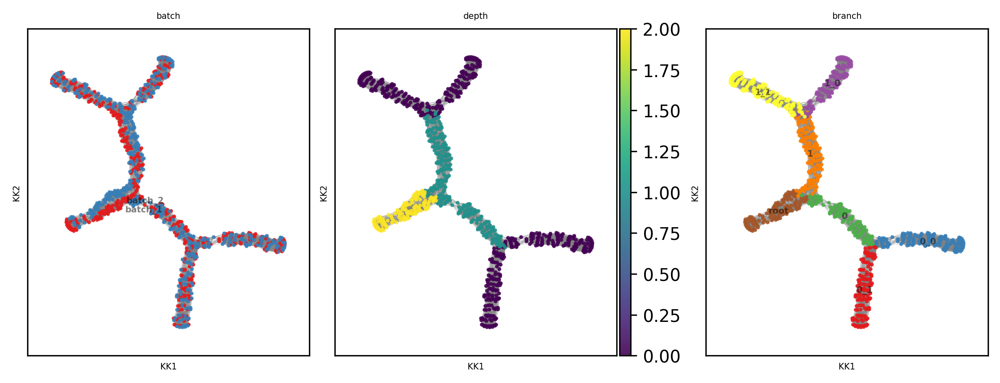

In [136]:
show_basis = 'Concord'
show_cols = [batch_key, group_key, 'branch']
layout='kk'
k=30

ccd.pl.plot_graph(
    adata, show_basis, k=k, layout=layout, edges=True,
    color_by=show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"{k}nn_graph_{show_basis}_{file_suffix}.png"
)

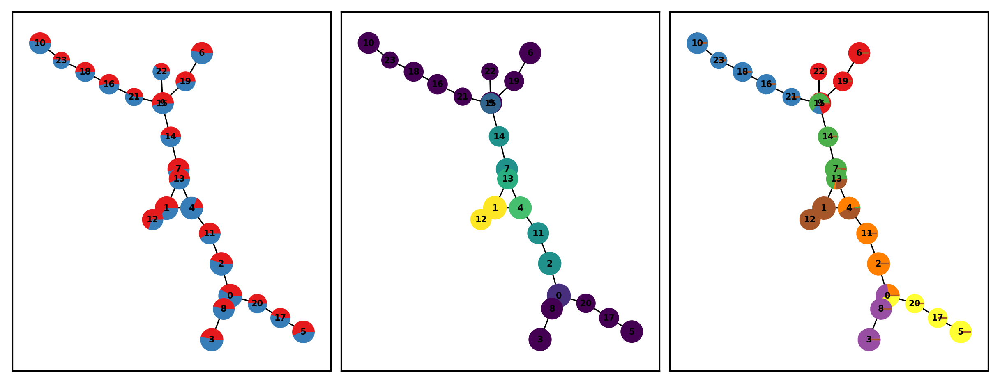

In [190]:
show_basis = 'Concord'
show_cols = [batch_key, group_key, 'branch']
layout='kk'
k=30

ccd.pl.plot_paga(
    adata, show_basis, k=k, layout=layout, 
    color_by=show_cols, 
    node_size_scale=1, edge_width_scale=0.1,
    figsize=(8,3), dpi=300, ncols=3, font_size=5, 
    save_path=save_dir / f"{k}nn_paga_{show_basis}_{file_suffix}.png"
)

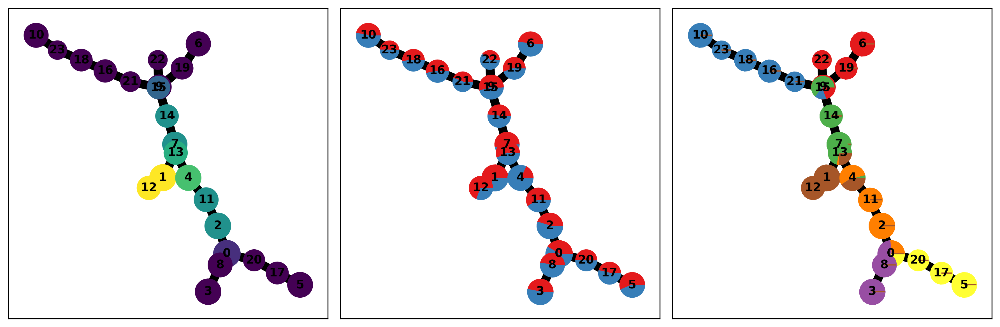

In [186]:
import matplotlib.pyplot as plt
fig, axes = plt.subplots(figsize=(12,4), ncols=3, dpi=300)
sc.pl.paga(adata, color='depth', show=False,
           cmap=None, ax=axes[0], 
                layout=layout, fontsize=10,
                node_size_scale=3, edge_width_scale=1, colorbar=False)
sc.pl.paga(adata, color='batch', show=False,
               cmap=None, ax=axes[1], 
                    layout=layout, fontsize=10,
                    node_size_scale=3, edge_width_scale=1)
sc.pl.paga(adata, color='branch', show=False,
               cmap=None, ax=axes[2], 
                    layout=layout, fontsize=10,
                    node_size_scale=3, edge_width_scale=1)
plt.tight_layout()
plt.savefig(save_dir / f"paga_{file_suffix}.png")

### 2. Geometric properties

#### 2.0 Latent intepretation

In [94]:
cur_ccd = ccd.Concord(adata=adata, 
                      input_feature=None, 
                      batch_size=32,
                      n_epochs=10,
                      lr=1e-2,
                      train_frac=1.0,
                      schedule_ratio = 0.97,
                      latent_dim=32, # latent dimension
                      encoder_dims = [64], # encoder architecture
                      decoder_dims = [64], # decoder architecture
                      norm_type = 'layer_norm',
                      use_importance_mask=False,
                      #importance_penalty_weight=1.0,
                      use_decoder=True,
                      domain_embedding_dim=8,
                      domain_key=batch_key, # key indicating batch
                      augmentation_mask_prob = 0.5, # augmentation mask probability, recommend between 0.1 and 0.7
                      clr_temperature = 0.5, # temperature for NT-Xent loss
                      seed=seed, # random seed
                      p_intra_domain = 1.0, # probability of intra-domain sampling
                      p_intra_knn=0.5,
                      sampler_knn = 128,
                      verbose=True, # print training progress
                      inplace=True, # whether to modify original adata, set to False if you want to keep all expressions
                      device=device, # device to run on
                      save_dir=save_dir # directory to save model checkpoints
                      ) 

# Encode data, saving the latent embedding in adata.obsm['Concord']
output_key = 'Concord'
cur_ccd.encode_adata(input_layer_key='X', output_key=output_key, preprocess=False, return_latent=True, return_decoded=True, decoder_domain='batch_1')
# Save the latent embedding to a file, so that it can be loaded later
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, save_dir / f"obsm_{file_suffix}.h5")

Concord - WARNING - No input feature list provided. It is recommended to first select features using the command `concord.ul.select_features()`.
Concord - INFO - Proceeding with all 387 features in the dataset.
Concord - INFO - Column 'batch' is now of type: category
Concord - INFO - Encoder input dim: 387
Concord - INFO - Decoder input dim: 40
Concord - INFO - Model loaded to device: cpu
Concord - INFO - Total number of parameters: 55027
Concord.model.anndataset - INFO - Initialized dataset with 434 samples. Data structure: ['input', 'domain', 'idx']
Concord.model.dataloader - INFO - Using existing embedding 'X_pca' from adata.obsm
Concord.model.knn - WARNING - FAISS not found. Using sklearn for k-NN computation.
Concord.model.dataloader - INFO - Number of unique_domains: 2
Concord.model.dataloader - INFO - Final p_intra_domain values: batch_1: 1.00, batch_2: 1.00
p_intra_knn: 0.5
Concord - INFO - Starting epoch 1/10
Concord - INFO - Processing chunk 1/1 for epoch 1
Concord - INFO - N

Epoch 0 Training: 12it [00:00, 94.49it/s, loss=22.4]

Concord - INFO - Epoch   0 | Train Loss:27.56, MSE:23.54, CLASS: 0.00, CONTRAST: 4.02, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 2/10
Concord - INFO - Processing chunk 1/1 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 434



Epoch 1 Training: 100%|██████████| 12/12 [00:00<00:00, 102.42it/s, loss=13.7]

Concord - INFO - Epoch   1 | Train Loss:17.25, MSE:13.51, CLASS: 0.00, CONTRAST: 3.74, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 3/10
Concord - INFO - Processing chunk 1/1 for epoch 3


Concord - INFO - Number of samples in train_dataloader: 434


Epoch 2 Training: 100%|██████████| 12/12 [00:00<00:00, 65.68it/s, loss=11.4]

Concord - INFO - Epoch   2 | Train Loss:12.52, MSE: 8.95, CLASS: 0.00, CONTRAST: 3.57, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 4/10
Concord - INFO - Processing chunk 1/1 for epoch 4
Concord - INFO - Number of samples in train_dataloader: 434



Epoch 3 Training: 100%|██████████| 12/12 [00:00<00:00, 102.61it/s, loss=9.01]

Concord - INFO - Epoch   3 | Train Loss: 9.34, MSE: 5.83, CLASS: 0.00, CONTRAST: 3.51, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 5/10


Concord - INFO - Processing chunk 1/1 for epoch 5
Concord - INFO - Number of samples in train_dataloader: 434


Epoch 4 Training: 100%|██████████| 12/12 [00:00<00:00, 49.02it/s, loss=6.66]

Concord - INFO - Epoch   4 | Train Loss: 7.87, MSE: 4.41, CLASS: 0.00, CONTRAST: 3.46, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 6/10
Concord - INFO - Processing chunk 1/1 for epoch 6
Concord - INFO - Number of samples in train_dataloader: 434



Epoch 5 Training: 100%|██████████| 12/12 [00:00<00:00, 78.45it/s, loss=6.31]

Concord - INFO - Epoch   5 | Train Loss: 6.99, MSE: 3.61, CLASS: 0.00, CONTRAST: 3.38, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 7/10
Concord - INFO - Processing chunk 1/1 for epoch 7
Concord - INFO - Number of samples in train_dataloader: 434


Epoch 6 Training: 100%|██████████| 12/12 [00:00<00:00, 47.56it/s, loss=6.09]

Concord - INFO - Epoch   6 | Train Loss: 6.47, MSE: 3.11, CLASS: 0.00, CONTRAST: 3.36, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 8/10


Concord - INFO - Processing chunk 1/1 for epoch 8
Concord - INFO - Number of samples in train_dataloader: 434


Epoch 7 Training: 100%|██████████| 12/12 [00:00<00:00, 84.22it/s, loss=7.02]

Concord - INFO - Epoch   7 | Train Loss: 6.44, MSE: 3.05, CLASS: 0.00, CONTRAST: 3.38, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 9/10
Concord - INFO - Processing chunk 1/1 for epoch 9


Concord - INFO - Number of samples in train_dataloader: 434


Epoch 8 Training: 100%|██████████| 12/12 [00:00<00:00, 58.38it/s, loss=6.44]

Concord - INFO - Epoch   8 | Train Loss: 6.17, MSE: 2.83, CLASS: 0.00, CONTRAST: 3.34, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 10/10
Concord - INFO - Processing chunk 1/1 for epoch 10
Concord - INFO - Number of samples in train_dataloader: 434



Epoch 9 Training: 100%|██████████| 12/12 [00:00<00:00, 97.67it/s, loss=5.56]

Concord - INFO - Epoch   9 | Train Loss: 6.02, MSE: 2.72, CLASS: 0.00, CONTRAST: 3.30, IMPORTANCE: 0.00
Concord - INFO - Model saved to ../save/dev_simulation_ccd_tree-Oct29/final_model.pth
Concord - INFO - Final model saved at: ../save/dev_simulation_ccd_tree-Oct29/final_model.pth; Configuration saved at: ../save/dev_simulation_ccd_tree-Oct29/config.json.


Concord.model.anndataset - INFO - Initialized dataset with 434 samples. Data structure: ['input', 'domain', 'idx']
Concord - INFO - Predicting for chunk 1/1
Concord - INFO - Projecting data back to expression space of specified domain: batch_1


Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']


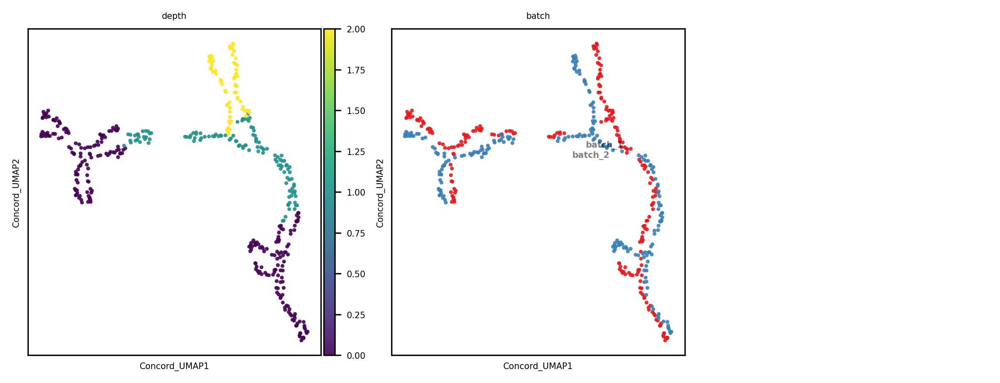

In [95]:
output_key = 'Concord'
ccd.ul.run_umap(adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_neighbors=30, min_dist=0.5, metric='euclidean', random_state=seed)
show_basis = f'{output_key}_UMAP'
show_cols = [group_key, batch_key]
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(8,3), dpi=300, ncols=3, font_size=5, point_size=20, legend_loc='on data',
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

In [93]:
# Predict and store the results
#decoder_domain = 'batch_1'
decoder_domain = 'batch_2'
encoded, decoded, class_preds, class_probs, class_true, latent_matrices = cur_ccd.predict(cur_ccd.loader, 
                                                                                        return_decoded=True, decoder_domain=decoder_domain,
                                                                                        return_latent=True,
                                                                                        return_class=False, return_class_prob=False)
save_key = f"{output_key}_decoded_{decoder_domain}"
adata.layers[save_key] = decoded
adata.layers

AttributeError: Can only use .cat accessor with a 'category' dtype